In [ ]:
### installing required libraries
!pip install super-gradients
!pip install imutils
!pip install roboflow
!pip install pytube --upgrade

In [2]:
## importing required libraries
import os
import shutil
import random

!pip install tqdm --upgrade
from tqdm.notebook import tqdm

In [3]:
## connecting to the google drive

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
### specifying data path

train_path_img = "./yolo_data/train/images/"
train_path_label = "./yolo_data/train/labels/"
val_path_img = "./yolo_data/valid/images/"
val_path_label = "./yolo_data/valid/labels/"
test_path = "./yolo_data/test/images/"
test_path_label = "./yolo_data/test/labels/"

In [5]:
'''
Split the dataset into train and test and creates the train.txt and test.tx with
the respective path of the images in each folder
'''

def train_test_split(path,neg_path=None, split = 0.2):
    print("------ PROCESS STARTED -------")


    files = list(set([name[:-4] for name in os.listdir(path)])) ## removing duplicate names i.e. counting only number of images


    print (f"--- This folder has a total number of {len(files)} images---")
    random.seed(42)
    random.shuffle(files)

    test_size = int(len(files) * split)
    train_size = len(files) - test_size

    ## creating required directories

    os.makedirs(train_path_img, exist_ok = True)
    os.makedirs(train_path_label, exist_ok = True)
    os.makedirs(val_path_img, exist_ok = True)
    os.makedirs(val_path_label, exist_ok = True)


    ### ----------- copying images to train folder
    for filex in tqdm(files[:train_size]):
      if filex == 'classes':
          continue
      shutil.copy2(path + filex + '.jpg',f"{train_path_img}/" + filex + '.jpg' )
      shutil.copy2(path + filex + '.txt', f"{train_path_label}/" + filex + '.txt')



    print(f"------ Training data created with 80% split {len(files[:train_size])} images -------")

    if neg_path:
        neg_images = list(set([name[:-4] for name in os.listdir(neg_path)])) ## removing duplicate names i.e. counting only number of images
        for filex in tqdm(neg_images):
            shutil.copy2(neg_path+filex+ ".jpg", f"{train_path_img}/" + filex + '.jpg')

        print(f"------ Total  {len(neg_images)} negative images added to the training data -------")

        print(f"------ TOTAL Training data created with {len(files[:train_size]) + len(neg_images)} images -------")



    ### copytin images to validation folder
    for filex in tqdm(files[train_size:]):
      if filex == 'classes':
          continue
      # print("running")
      shutil.copy2(path + filex + '.jpg', f"{val_path_img}/" + filex + '.jpg' )
      shutil.copy2(path + filex + '.txt', f"{val_path_label}/" + filex + '.txt')

    print(f"------ Testing data created with a total of {len(files[train_size:])} images ----------")

    print("------ TASK COMPLETED -------")

## spliting the data into train-test and creating train.txt and test.txt files
# train_test_split('/content/drive/MyDrive/custom_notebooks/yolo_data/')

### for label_tag
train_test_split('/content/drive/MyDrive/yolo_nas/data/') ### without negative images

------ PROCESS STARTED -------
--- This folder has a total number of 2177 images---


  0%|          | 0/1742 [00:00<?, ?it/s]

------ Training data created with 80% split 1742 images -------


  0%|          | 0/435 [00:00<?, ?it/s]

------ Testing data created with a total of 435 images ----------
------ TASK COMPLETED -------


In [ ]:
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val


dataset_params = {
    'data_dir':'/content/yolo_data',
    'train_images_dir':'train/images',
    'train_labels_dir':'train/labels',
    'val_images_dir':'valid/images',
    'val_labels_dir':'valid/labels',
    'test_images_dir':'/content/drive/MyDrive/yolo_nas/test/images',
    'test_labels_dir':'/content/drive/MyDrive/yolo_nas/test/labels',
    'classes': ['bottle']
}

In [7]:
import torch

MODEL_ARCH = 'yolo_nas_s'
DEVICE = 'cuda' if torch.cuda.is_available() else "cpu"
BATCH_SIZE = 8
MAX_EPOCHS = 10
CHECKPOINT_DIR = f'/content/drive/MyDrive/yolo_nas/training_backup'
EXPERIMENT_NAME = f'yolo_nas_l_e10'

In [8]:
### setting up dataloaders
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 2
    }
)

[2023-08-27 12:43:24] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 1742/1742 [00:00<00:00, 5065.35it/s]
[2023-08-27 12:43:24] WARNING - detection_dataset.py - Found 101 invalid bbox that were ignored. For more information, please set `show_all_warnings=True`.
[2023-08-27 12:43:24] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 435/435 [00:00<00:00, 7183.64it/s]
[2023-08-27 12:43:25] WARNING - detection_dataset.py - Found 34 invalid bbox that were ignored. For more information, please set `show_all_warnings=True`.
[2023-08-27 12:43:30] WARNING - yolo_format_detection.py - 131 label files are not associated to any image.
[2023-08-27 12:43:30] INFO - detection_dataset.py - Dataset I

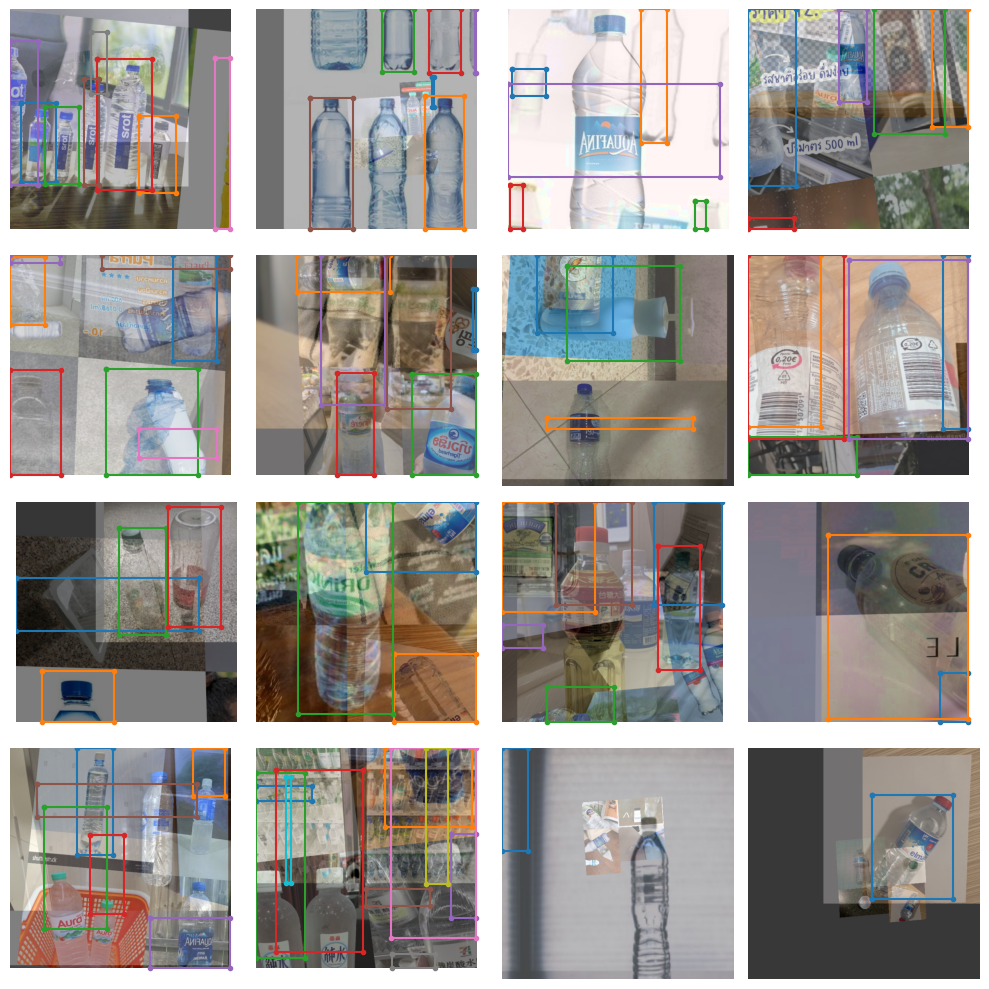

In [9]:
### applying custom transformations
train_data.dataset.transforms
### visualizing data after transformation
train_data.dataset.plot()

In [10]:
from super_gradients.training import models

model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    pretrained_weights="coco"
)

[2023-08-27 12:45:43] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_s_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_s_coco.pth
100%|██████████| 73.1M/73.1M [00:00<00:00, 208MB/s]
[2023-08-27 12:45:43] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_s


In [11]:
#Installing th model
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback

train_params = {
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    "max_epochs": MAX_EPOCHS,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

In [12]:
from super_gradients.training import Trainer

trainer = Trainer(experiment_name=EXPERIMENT_NAME, ckpt_root_dir=CHECKPOINT_DIR)

In [13]:
# %load_ext tensorboard
# %tensorboard --logdir {CHECKPOINT_DIR}/{EXPERIMENT_NAME}


In [ ]:
trainer.train(model=model,
              training_params=train_params,
              train_loader=train_data,
              valid_loader=val_data)

In [15]:
best_model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    checkpoint_path=f"{CHECKPOINT_DIR}/{EXPERIMENT_NAME}/average_model.pth"
).to(DEVICE)

[2023-08-27 13:52:15] INFO - checkpoint_utils.py - Successfully loaded model weights from /content/drive/MyDrive/yolo_nas/training_backup/yolo_nas_l_e10/average_model.pth EMA checkpoint.


In [16]:
trainer.test(model=best_model,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1,
                                                   top_k_predictions=300,
                                                   num_cls=len(dataset_params['classes']),
                                                   normalize_targets=True,
                                                   post_prediction_callback=PPYoloEPostPredictionCallback(score_threshold=0.01,
                                                                                                          nms_top_k=1000,
                                                                                                          max_predictions=300,
                                                                                                          nms_threshold=0.7)
                                                  ))


Testing:  98%|█████████▊| 64/65 [01:32<00:00,  2.26it/s]

{'PPYoloELoss/loss_cls': 1.2484224,
 'PPYoloELoss/loss_iou': 0.33504987,
 'PPYoloELoss/loss_dfl': 1.9747734,
 'PPYoloELoss/loss': 3.0734332,
 'Precision@0.50': 0.012548945844173431,
 'Recall@0.50': 0.4716311991214752,
 'mAP@0.50': 0.2973003387451172,
 'F1@0.50': 0.024447405710816383}

[2023-08-27 14:19:34] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


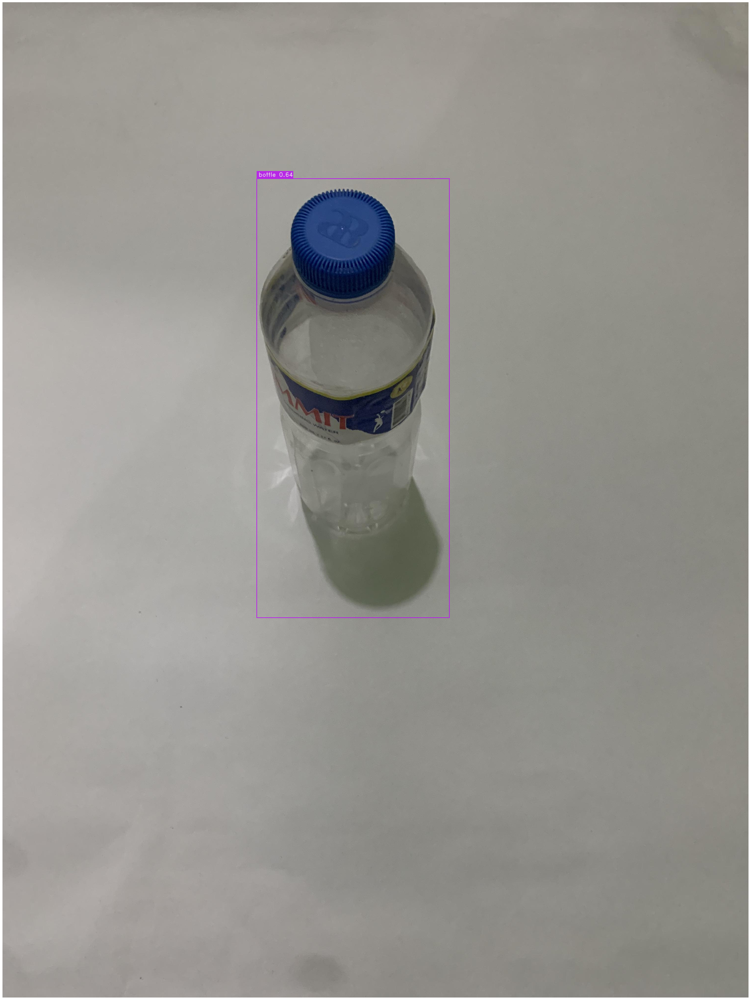

In [22]:
img_dir = "/content/drive/MyDrive/yolo_nas/irl_sample.jpg"
best_model.predict(img_dir).show()

[2023-08-27 14:24:53] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


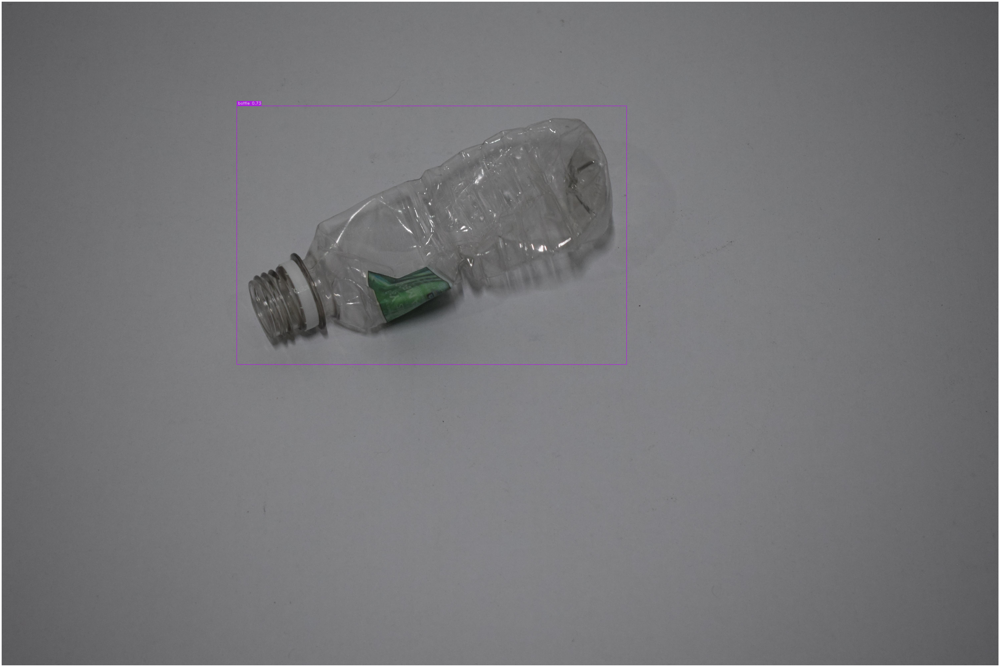

In [23]:
img_dir = "/content/drive/MyDrive/yolo_nas/irl_sample2.jpg"
best_model.predict(img_dir).show()